## Logistic Regression - Rain Prediction and Data Analysis

### How to run the code


You could download this notebook from: <githublink>, and you should install all the required packages before running the code locally. And you can download the dataset from: 

https://www.kaggle.com/datasets/jsphyg/weather-dataset-rattle-package<linkofkaggle>

## Problem Statement

Consider you are working with a weather forecasting agency that aims to improve its predictions of rain across Australia. As a Data Scientist, your task is to create an automated system that predicts whether it will rain the next day. Your prediction model should take into account features such as location, temperature, humidity, wind speed, and other relevant weather parameters.

The rain predictions from your system will not only assist in rain prediction but they must also provide clear explanations for each prediction it makes.

To assist you in this task, you are provided with a CSV file containing a decade's worth of daily weather observations from various Australian locations. The historical dataset includes weather parameters along with a binary indicator "RainTomorrow", denoting whether it rained the next day (1mm or more, 'Yes') or not ('No').

Your job is to use this data to build a prediction system capable of accurately forecasting rain for any given day, even if that day's data is not part of the initial dataset.

## Importing libraries

In [24]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn import metrics
import seaborn as sns
import plotly.express as px
import numpy as np


In [25]:
data = pd.read_csv('weatherAUS.csv')

## Exploratory Data Analysis and Visualization

In order to understand the data that's available, we must perform data analysis by vizualizing the distribution of values in each feature, and the relationships between selling price and other features. By features I mean the columns of the data.

In [26]:
data

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145455,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
145456,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
145457,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
145458,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


The dataset contains 145460 rows and 23 columns. Each row in the dataset contains information (columns)  also called features about weather on that specific day.
The task is to find a way to estimate the value in the "RainTomorrow" column using the values in the other columns. If we can do this estimation for historical data, then we should be able to estimate RainTomorrow for future dates that are not part of this set, simply by providing information like temperature, humidity, wind speed, and other relevant weather parameters.

Check the datatypes of each column

In [27]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  object 
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  object 
 10  WindDir3pm     141232 non-null  object 
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

Check the missing values of each column

In [28]:
data.isnull().sum()

Date                 0
Location             0
MinTemp           1485
MaxTemp           1261
Rainfall          3261
Evaporation      62790
Sunshine         69835
WindGustDir      10326
WindGustSpeed    10263
WindDir9am       10566
WindDir3pm        4228
WindSpeed9am      1767
WindSpeed3pm      3062
Humidity9am       2654
Humidity3pm       4507
Pressure9am      15065
Pressure3pm      15028
Cloud9am         55888
Cloud3pm         59358
Temp9am           1767
Temp3pm           3609
RainToday         3261
RainTomorrow      3267
dtype: int64

Since there are not too many missing values in RainTomorow category, I will remove all days where this value is missing, since it's important to have only accuracte values if possible, before training our model.

In [29]:
data.shape

(145460, 23)

In [30]:
data.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,143975.000000,144199.000000,142199.000000,82670.000000,75625.000000,135197.000000,143693.000000,142398.000000,142806.000000,140953.000000,130395.00000,130432.000000,89572.000000,86102.000000,143693.000000,141851.00000
mean,12.194034,23.221348,2.360918,5.468232,7.611178,40.035230,14.043426,18.662657,68.880831,51.539116,1017.64994,1015.255889,4.447461,4.509930,16.990631,21.68339
std,6.398495,7.119049,8.478060,4.193704,3.785483,13.607062,8.915375,8.809800,19.029164,20.795902,7.10653,7.037414,2.887159,2.720357,6.488753,6.93665
min,-8.500000,-4.800000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.50000,977.100000,0.000000,0.000000,-7.200000,-5.40000
25%,7.600000,17.900000,0.000000,2.600000,4.800000,31.000000,7.000000,13.000000,57.000000,37.000000,1012.90000,1010.400000,1.000000,2.000000,12.300000,16.60000
50%,12.000000,22.600000,0.000000,4.800000,8.400000,39.000000,13.000000,19.000000,70.000000,52.000000,1017.60000,1015.200000,5.000000,5.000000,16.700000,21.10000
75%,16.900000,28.200000,0.800000,7.400000,10.600000,48.000000,19.000000,24.000000,83.000000,66.000000,1022.40000,1020.000000,7.000000,7.000000,21.600000,26.40000
max,33.900000,48.100000,371.000000,145.000000,14.500000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.00000,1039.600000,9.000000,9.000000,40.200000,46.70000


In [31]:
data.dropna(subset=['RainToday', 'RainTomorrow'], inplace=True)

In [32]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 140787 entries, 0 to 145458
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           140787 non-null  object 
 1   Location       140787 non-null  object 
 2   MinTemp        140319 non-null  float64
 3   MaxTemp        140480 non-null  float64
 4   Rainfall       140787 non-null  float64
 5   Evaporation    81093 non-null   float64
 6   Sunshine       73982 non-null   float64
 7   WindGustDir    131624 non-null  object 
 8   WindGustSpeed  131682 non-null  float64
 9   WindDir9am     131127 non-null  object 
 10  WindDir3pm     137117 non-null  object 
 11  WindSpeed9am   139732 non-null  float64
 12  WindSpeed3pm   138256 non-null  float64
 13  Humidity9am    139270 non-null  float64
 14  Humidity3pm    137286 non-null  float64
 15  Pressure9am    127044 non-null  float64
 16  Pressure3pm    127018 non-null  float64
 17  Cloud9am       88162 non-null

Now we begin to explore some features

The plot below shows that the distribution of Location feature is uniform, in each city the rainy days are almost the same. Except some of them like Uluru, Katherince and Nhil. But, this also can be due to the count that's also lower in this areas, there's prolly more missing values since they didn't measure the weather fully in this last 10 years.

In [33]:
## Explore rainy days over all locations in Australia
px.histogram(data, x='Location', color='RainToday', title='Rainy days over all locations in Australia')

In [34]:
data.Location.nunique()

49

The plots below shows the correlation between low temperatures at 3pm and the chances of rain tomorrow, or low temperatures in the morning and chances of raining on that day. We can see from the plot that that's true which is also intuitive assumption. The lower the temperatures in 3pm the higher the chances of raining tomorrow.

In [35]:
px.histogram(data, x='Temp3pm', color='RainTomorrow', title='Rain Tomorrow vs Temperature at 3pm')

In [36]:
px.histogram(data, x='Temp9am', color='RainToday', title='Rain Today vs Temperature at 9am')

It's important to check the distribution of our Target Variable RainTomorrow

In [37]:
px.histogram(data, x='RainTomorrow', color='RainToday', title='Rain Tomorrow vs Rain Today')

In the plot above, we could tell that our RainTomorrow, the feature (class) that we're trying to predict, is not equally represented in the dataset. This means that our data is imbalanced, since there are more days when there's no rain than when there is rain.

From this distribution we can see that if it did not rain today, there's a high chance that it won't rain tomorrow (we can see this from the RainTomorrow No bar), on the other hand if we look at the Raintomorrow YES, it's pretty hard to conclude whether it's gonna raintomorrow from RainToday yes or no.

This makes it harder for our model to predict whether it's gonna rain tommorrow and easier to predict if it's NOT going to rain tomorrow.

In [38]:
px.scatter(data.sample(1000), x='MinTemp', y='MaxTemp', color='RainToday', title='MinTemp and MaxTemp vs RainToday')

From the plot above, we could observe that there's a linear coorelation between MinTemp and MaxTemp in a day, and if we check the RainToday = Yes data points, we could see that in the days that it has rained, there's not much difference between Min and Max Temperature

<Axes: >

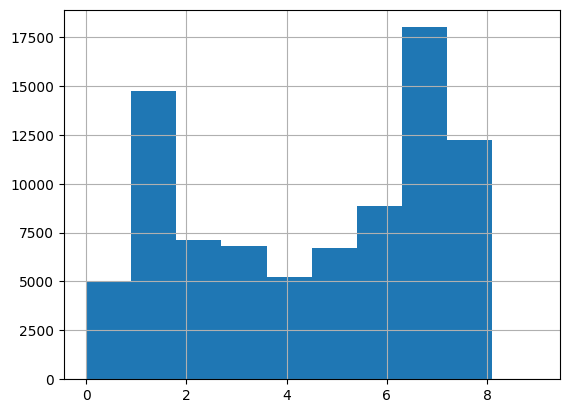

In [39]:
data.Cloud3pm.hist()

In [40]:
px.histogram(data, x='Cloud3pm', color='RainTomorrow', title='Cloud at 3pm vs Rain Tomorrow')

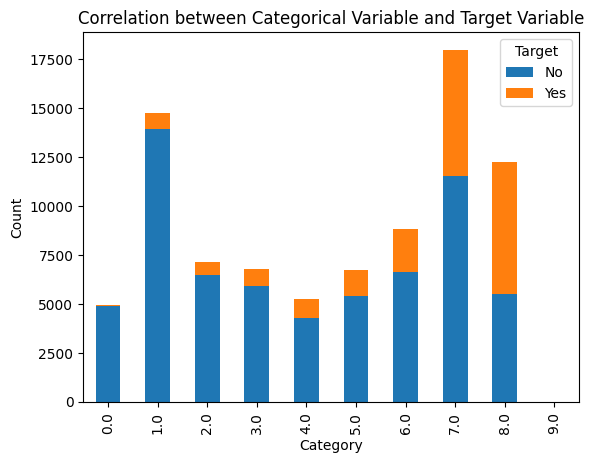

In [41]:
# Grouping the data by category and target and calculating the count
grouped_data = data.groupby(['Cloud3pm', 'RainTomorrow']).size().unstack()
grouped_data.plot(kind='bar', stacked=True)
plt.xlabel('Category')
plt.ylabel('Count')
plt.title('Correlation between Categorical Variable and Target Variable')
plt.legend(title='Target')
plt.show()

Based on the plots above, we could see that there's a correlation between clouds at 3pm and raining tomorrow. If the cloud at 3pm's value is 7 or 8 there's a high chance of raining tomorrow.

In [42]:
px.histogram(data, x='WindSpeed3pm', color='RainTomorrow', title='Rain Tomorrow vs Temperature at 3pm')

In [43]:
px.scatter(x='Temp3pm', y='Humidity3pm', color='RainTomorrow', data_frame=data.sample(8000), title='Rain Tomorrow vs Temperature at 3pm, Humidity at 3pm')

So, if the humidity is greater then 50 and temperature are relatively low, there's more chance of raining tommorrow.

In [44]:
px.scatter(x='Temp9am', y='Humidity9am', color='RainToday', data_frame=data.sample(8000), title='Rain Today vs Temperature at 3pm, Humidity at 3pm')

We get similar results if by checking humidity and temperature at 9am.

### Train / Test / Validation Splits

Training Set: This is the set of the dataset and is used to train the machine learning model. The model learns from this data and tunes its parameters to minimize the difference between the predicted and actual values of the target variable. The training set usually accounts for about 60-80% of the dataset.

Validation Set: The validation set is used to evaluate the performance of the model during the training phase and fine-tune the model's hyperparameters (parameters that are not learned from the data, but are set by the practitioner, like learning rate in gradient descent). The model does not learn from this data in the traditional sense, but rather, it's used to prevent overfitting to the training data. The validation set helps ensure that the model generalizes well to unseen data. It typically comprises about 10-20% of the dataset.

Test Set: This is the data that the model has never seen during its training or validation phase. It's used to evaluate the final performance of the model after all training and validation has been completed. This helps us understand how the model will perform when it's used to make predictions on new, unseen data in the real world. Like the validation set, the test set usually makes up about 10-20% of the dataset.

Separating data into these three sets is important because it allows us to make sure our model not only performs well on the data it was trained on, but also generalizes well to new, unseen data. This process helps us avoid overfitting, where a model learns the training data so well that it performs poorly when faced with new data.

In [45]:
train_val_df, test_df = train_test_split(data, test_size=0.2, random_state=42) # get 20% of data for testing (test_df)
train_df, val_df = train_test_split(train_val_df, test_size=0.25, random_state=42) # from 80% remaining data, get 25% for validation (val_df), and the remaining train_df for training.

<Axes: xlabel='Year', ylabel='count'>

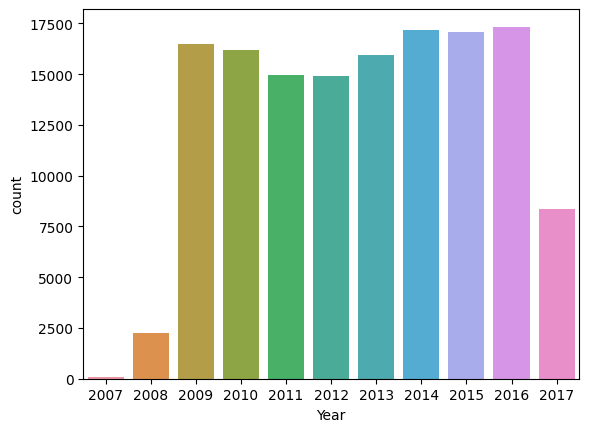

In [46]:
data['Date'] = pd.to_datetime(data['Date']) # convert Date column to datetime format
data['Year'] = data['Date'].dt.year # extract year from Date column

sns.countplot(x=data['Year'])

Since we're trying to predict if it's going to rain in the future, it's logically to train the data accordingly too. For example its better to use a training set for historical date (using 2007 until 2014), then use data in the future for validation for example 2015, 2016 for hyperparameter tuning and then use 2017's data for prediction (testing our model)

In [47]:
train_df = data[data['Year'] < 2015] # get data before 2015 for training
val_df = data[data['Year'] == 2015]  # get data in 2015 for validation
test_df = data[data['Year'] > 2015]  # get data after 2015 for testing

### Identify the Inputs and Target

There's no point on training the model using the Date column since, the other features based on are analysis they're important for our prediction. since there is a correlation of raining today / tomorrow using those columns.

The Target Column will be RainTomorrow, and we should remove it from our input.

In this dataset there's a column location, we're using it in our model, but this means that this model can be used then only to make prediction on certain location given in training set,
if we would like to make it more general, the location column should be removed.

### Handling Missing Data

Handling missing values is a very important step in data preprocessing. The strategy to handle these missing values depends based on the type of data and the nature of the problem.

For numerical data, it's common to use the following techniques:

Drop: Remove rows with missing values.
Mean/Median: Replace missing values with the mean or median of the non-missing values. Mean is sensitive to outliers while median is not, it might be more suitable to use median.
Random: Substitute missing values with a random value from the available data.
K-Nearest Neighbors (KNN): Impute missing values using the KNN algorithm, which fills missing values based on similar "neighbour" observations.

For categorical data, it's common to use the following techniques:

Drop: Remove rows with missing values.
Mode: Replace missing values with the mode (most frequent value).
Random: Same as for numerical data.
KNN: Can also be used for categorical data, where the most common class among the K-nearest neighbors replaces the missing value.
Choosing the right method depends on the specific data, the importance of the feature, and the proportion of missing values.

There are more techiques for handling missing values, and they really important and depending on problem you might expertiment with different approaches.

In [48]:
numerical_columns = train_df.select_dtypes(include=np.number).columns # get numerical columns 
categorical_columns = train_df.select_dtypes('object').columns # get categorical columns

In [49]:
train_df[categorical_columns].nunique()

Location        49
WindGustDir     16
WindDir9am      16
WindDir3pm      16
RainToday        2
RainTomorrow     2
dtype: int64

In [50]:
def handle_missing(table, columns = None, method = 'drop'):
    table = table.copy()
    if columns is None:
        columns = table.columns
    for col in columns:
        if method == 'drop':
            table[col].dropna(inplace=True)
        elif method == 'mode':
            table[col].fillna(table[col].mode()[0], inplace = True)
        elif method == 'median':
            table[col].fillna(table[col].median(), inplace = True)
        elif method == 'mean':
            table[col].fillna(table[col].mean(), inplace = True)
        elif method == 'random':
            table[col] = table[col].apply(lambda x: np.random.choice(table[col].dropna().values) if np.isnan(x) else x)
    return table

In [51]:
train_df = handle_missing(train_df, columns=numerical_columns, method='mean')
test_df = handle_missing(test_df, columns=numerical_columns, method='mean')
val_df = handle_missing(val_df, columns=numerical_columns, method='mean')

y_train = train_df['RainTomorrow']
y_test = test_df['RainTomorrow']
y_val = val_df['RainTomorrow']

train_df = train_df.drop(['RainTomorrow'],axis=1)
test_df = test_df.drop(['RainTomorrow'],axis=1)
val_df = val_df.drop(['RainTomorrow'],axis=1)

In [52]:
train_df.isnull().sum()

Date                0
Location            0
MinTemp             0
MaxTemp             0
Rainfall            0
Evaporation         0
Sunshine            0
WindGustDir      6868
WindGustSpeed       0
WindDir9am       7019
WindDir3pm       1952
WindSpeed9am        0
WindSpeed3pm        0
Humidity9am         0
Humidity3pm         0
Pressure9am         0
Pressure3pm         0
Cloud9am            0
Cloud3pm            0
Temp9am             0
Temp3pm             0
RainToday           0
Year                0
dtype: int64

### Scaling Numeric Features

Scaling numerical features to a certain range (like 0 to 1 or -1 to 1) is a good practice in machine learning. It helps ensure that all features contribute equally to the model's prediction by preventing any single feature from dominating due to its larger scale. Additionally, it makes optimization algorithms more effective, as they usually function better with smaller numbers.

For example:

Consider two data points:

Person A: Age = 25, Income = $50,000

Person B: Age = 50, Income = $100,000

Without scaling, the income feature would overpower the age feature due to its larger values, affecting our model's learning.

By applying min-max scaling, we adjust the values:

Person A: Scaled Age = 0, Scaled Income = 0

Person B: Scaled Age = 1, Scaled Income = 1

Now, both features have the same range, allowing the model to learn from both without bias.

In [53]:
from sklearn.preprocessing import MinMaxScaler

In [54]:
train_df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Year
count,97988.000000,97988.000000,97988.000000,97988.000000,97988.000000,97988.000000,97988.000000,97988.000000,97988.000000,97988.000000,97988.000000,97988.000000,97988.000000,97988.000000,97988.000000,97988.000000,97988.000000
mean,12.007831,23.022202,2.372935,5.289991,7.609004,40.215873,14.092263,18.764608,68.628745,51.469547,1017.513734,1015.132352,4.302952,4.410677,16.835126,21.540138,2011.430226
std,6.336997,6.977729,8.518819,3.134884,2.913479,13.212094,8.944046,8.823868,18.900812,20.637576,6.735644,6.663087,2.298554,2.141830,6.385800,6.810804,1.802640
min,-8.500000,-4.100000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.500000,979.000000,0.000000,0.000000,-5.900000,-5.100000,2007.000000
25%,7.500000,17.900000,0.000000,3.800000,7.500000,31.000000,7.000000,13.000000,57.000000,37.000000,1013.400000,1010.900000,3.000000,3.000000,12.200000,16.600000,2010.000000
50%,11.800000,22.400000,0.000000,5.289991,7.609004,39.000000,13.000000,19.000000,69.000000,52.000000,1017.513734,1015.132352,4.302952,4.410677,16.600000,21.000000,2011.000000
75%,16.600000,27.900000,0.800000,5.600000,9.200000,46.000000,19.000000,24.000000,83.000000,65.000000,1021.800000,1019.300000,6.000000,6.000000,21.300000,26.100000,2013.000000
max,33.900000,48.100000,371.000000,82.400000,14.300000,135.000000,87.000000,87.000000,100.000000,100.000000,1041.000000,1039.600000,9.000000,9.000000,40.200000,46.100000,2014.000000


In [55]:

scaler = MinMaxScaler()
scaler.fit(data[numerical_columns])

MinMaxScaler()

In [56]:
train_df[numerical_columns] = scaler.transform(train_df[numerical_columns])
val_df[numerical_columns] = scaler.transform(val_df[numerical_columns])
test_df[numerical_columns] = scaler.transform(test_df[numerical_columns])

In [57]:
val_df[numerical_columns].describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Year
count,17089.000000,17089.000000,17089.000000,17089.000000,17089.000000,17089.000000,17089.000000,17089.000000,17089.000000,17089.000000,17089.000000,17089.000000,17089.000000,17089.000000,17089.000000,17089.000000,1.708900e+04
mean,0.488170,0.535033,0.005756,0.040933,0.534232,0.260249,0.106295,0.211999,0.681261,0.504118,0.638269,0.632835,0.497727,0.500252,0.512648,0.523882,8.000000e-01
std,0.154319,0.141261,0.022310,0.022885,0.176740,0.097922,0.066596,0.099314,0.197918,0.207203,0.110797,0.107199,0.255668,0.237140,0.143843,0.137757,1.990688e-13
min,0.007075,0.030246,0.000000,0.000000,0.000000,0.007752,0.000000,0.000000,0.040000,0.000000,0.125620,0.081600,0.000000,0.000000,0.021097,0.026871,8.000000e-01
25%,0.375000,0.429112,0.000000,0.035862,0.534232,0.193798,0.053846,0.149425,0.560000,0.360000,0.568595,0.564800,0.333333,0.444444,0.409283,0.424184,8.000000e-01
50%,0.485849,0.525520,0.000000,0.040933,0.534232,0.255814,0.100000,0.211999,0.690000,0.504118,0.638269,0.632835,0.497727,0.500252,0.508439,0.518234,8.000000e-01
75%,0.601415,0.637051,0.001617,0.040933,0.572414,0.310078,0.146154,0.275862,0.830000,0.640000,0.705785,0.699200,0.666667,0.666667,0.616034,0.618042,8.000000e-01
max,0.952830,0.948960,0.666307,0.485517,1.000000,1.000000,0.669231,0.850575,1.000000,1.000000,0.971901,0.963200,0.888889,0.888889,0.943038,0.925144,8.000000e-01


 ### Encoding Categorical Data

Before we can apply machine learning algorithms to categorical variables, we need to transform them into numerical form. This process is known as encoding.

For instance, take the 'Transmission' column, which contains 'Manual' and 'Automatic'. Given that there are only two categories, we can use binary encoding: assign '0' to 'Manual' and '1' to 'Automatic', or vice versa.

In the case of 'Fuel_Type' with three categories, we can apply One-Hot-Encoding. Here, each category gets its own column in the data, and these new columns are binary, indicating the presence (1) or absence (0) of that category for a given record.

One-Hot-Encoding is particularly useful when the categories do not have a natural order or hierarchy, as is the case with 'Fuel_Type'. It prevents the machine learning algorithm from assigning inappropriate weight or importance to the categories based on numerical value.

However, one should be cautious when using One-Hot-Encoding with a variable that has many categories. This is because it can lead to a high increase in the number of columns (dimensionality) in your dataset, making it sparse and potentially harder to work with - a situation often referred to as the "Curse of Dimensionality". In such situations, other encoding techniques such as ordinal encoding or target encoding might be more appropriate.


An example of One Hot Encoding:

![image.png](attachment:image.png)

In [58]:
from sklearn.preprocessing import OneHotEncoder

In [59]:
## Remove RainTommorrow from categorical since we're gonna use it to create our dataframes etc.
categorical_columns = categorical_columns.drop('RainTomorrow')

In [60]:
encoder = OneHotEncoder(sparse=False, handle_unknown = 'ignore') 
encoder.fit(data[categorical_columns])

/Users/diellor/opt/anaconda3/lib/python3.8/site-packages/sklearn/preprocessing/_encoders.py:868: FutureWarning:

`sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.



OneHotEncoder(handle_unknown='ignore', sparse=False, sparse_output=False)

In [61]:
encoder.categories_

[array(['Adelaide', 'Albany', 'Albury', 'AliceSprings', 'BadgerysCreek',
        'Ballarat', 'Bendigo', 'Brisbane', 'Cairns', 'Canberra', 'Cobar',
        'CoffsHarbour', 'Dartmoor', 'Darwin', 'GoldCoast', 'Hobart',
        'Katherine', 'Launceston', 'Melbourne', 'MelbourneAirport',
        'Mildura', 'Moree', 'MountGambier', 'MountGinini', 'Newcastle',
        'Nhil', 'NorahHead', 'NorfolkIsland', 'Nuriootpa', 'PearceRAAF',
        'Penrith', 'Perth', 'PerthAirport', 'Portland', 'Richmond', 'Sale',
        'SalmonGums', 'Sydney', 'SydneyAirport', 'Townsville',
        'Tuggeranong', 'Uluru', 'WaggaWagga', 'Walpole', 'Watsonia',
        'Williamtown', 'Witchcliffe', 'Wollongong', 'Woomera'],
       dtype=object),
 array(['E', 'ENE', 'ESE', 'N', 'NE', 'NNE', 'NNW', 'NW', 'S', 'SE', 'SSE',
        'SSW', 'SW', 'W', 'WNW', 'WSW', nan], dtype=object),
 array(['E', 'ENE', 'ESE', 'N', 'NE', 'NNE', 'NNW', 'NW', 'S', 'SE', 'SSE',
        'SSW', 'SW', 'W', 'WNW', 'WSW', nan], dtype=object),
 ar

In [62]:
encoded_columns = list(encoder.get_feature_names_out(categorical_columns))

In [63]:
print(encoded_columns)

['Location_Adelaide', 'Location_Albany', 'Location_Albury', 'Location_AliceSprings', 'Location_BadgerysCreek', 'Location_Ballarat', 'Location_Bendigo', 'Location_Brisbane', 'Location_Cairns', 'Location_Canberra', 'Location_Cobar', 'Location_CoffsHarbour', 'Location_Dartmoor', 'Location_Darwin', 'Location_GoldCoast', 'Location_Hobart', 'Location_Katherine', 'Location_Launceston', 'Location_Melbourne', 'Location_MelbourneAirport', 'Location_Mildura', 'Location_Moree', 'Location_MountGambier', 'Location_MountGinini', 'Location_Newcastle', 'Location_Nhil', 'Location_NorahHead', 'Location_NorfolkIsland', 'Location_Nuriootpa', 'Location_PearceRAAF', 'Location_Penrith', 'Location_Perth', 'Location_PerthAirport', 'Location_Portland', 'Location_Richmond', 'Location_Sale', 'Location_SalmonGums', 'Location_Sydney', 'Location_SydneyAirport', 'Location_Townsville', 'Location_Tuggeranong', 'Location_Uluru', 'Location_WaggaWagga', 'Location_Walpole', 'Location_Watsonia', 'Location_Williamtown', 'Loca

In [64]:
train_df[encoded_columns] = encoder.transform(train_df[categorical_columns].fillna('Unknown'))
val_df[encoded_columns] = encoder.transform(val_df[categorical_columns].fillna('Unknown'))
test_df[encoded_columns] = encoder.transform(test_df[categorical_columns].fillna('Unknown'))

/var/folders/g8/kbvj9nqs6_b2jngf6hqjvfxw0000gn/T/ipykernel_40256/3547519225.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/g8/kbvj9nqs6_b2jngf6hqjvfxw0000gn/T/ipykernel_40256/3547519225.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/g8/kbvj9nqs6_b2jngf6hqjvfxw0000gn/T/ipykernel_40256/3547519225.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.co

In [65]:
train_df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,WindDir3pm_nan,RainToday_No,RainToday_Yes
0,2008-12-01,Albury,0.516509,0.523629,0.001617,0.036483,0.524759,W,0.294574,W,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
1,2008-12-02,Albury,0.375000,0.565217,0.000000,0.036483,0.524759,WNW,0.294574,NNW,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
2,2008-12-03,Albury,0.504717,0.576560,0.000000,0.036483,0.524759,WSW,0.310078,W,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
3,2008-12-04,Albury,0.417453,0.620038,0.000000,0.036483,0.524759,NE,0.139535,SE,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,2008-12-05,Albury,0.613208,0.701323,0.002695,0.036483,0.524759,W,0.271318,ENE,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144548,2014-12-27,Uluru,0.599057,0.718336,0.000000,0.036483,0.524759,SSE,0.286822,ESE,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
144549,2014-12-28,Uluru,0.556604,0.786389,0.000000,0.036483,0.524759,NE,0.193798,ENE,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
144550,2014-12-29,Uluru,0.608491,0.805293,0.000000,0.036483,0.524759,ESE,0.255814,ESE,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
144551,2014-12-30,Uluru,0.674528,0.818526,0.000000,0.036483,0.524759,ESE,0.286822,ESE,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [66]:
train_df = train_df.drop(categorical_columns, axis=1)

In [67]:
test_df = test_df.drop(categorical_columns, axis=1)
val_df = val_df.drop(categorical_columns, axis=1)

In [68]:
train_df = train_df.drop(['Date', 'Year'], axis=1)
val_df = val_df.drop(['Date', 'Year'], axis=1)
test_df = test_df.drop(['Date', 'Year'], axis=1) 

## Logistic Regression

Logistic regression is a classification learning algorithm. The explanation will be in a case of binary classification. However, it can be extended to multiclass classification.
In logistic Regression, similar to linear regression we sill want to model our output yi (i-th example in our dataset) as a linear function of xi ( yi = w * xi + b), but this would result in a function that can have values from minus infinity to plus infinity (continues value same as in linear regression). But, in our problem the yi values can only be Yes or No (Remeber, RainTomorrow can be Yes or No).

As a solution to this problem, we could encode the positive labels as 1, and negative labels as 0 (In our case would be 'Yes' = 1, 'No' = 0), and then we just need to find a simple continuous
function whose codomain is (0, 1). In such a case, if the value returned by the model for input x is closer to 0, then we assign a negative label to x; otherwise, the example is labeled
as positive. One function that has such a property is the standard logistic function (also known as the sigmoid function):

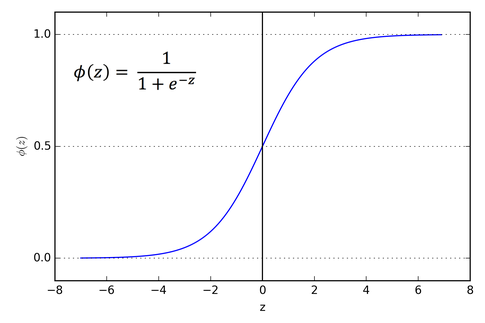

So now in instead of z, we just replace it with our well known linear combination of features. (x * w + b), whichever value is returned by this, would be in a range of 0,1, and then we can set a threshold for example for values greater then 0.5 we classify them as Yes, and for values smaller then 0.5 we classify them as No.

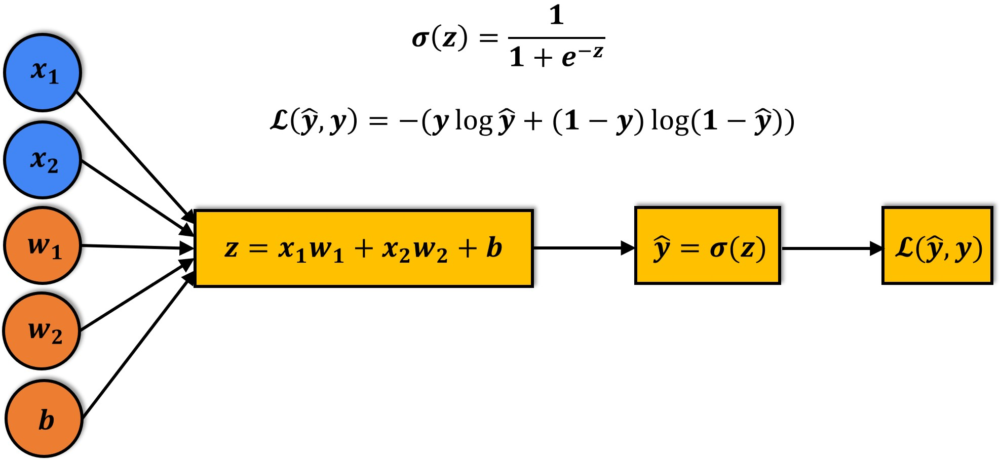

So, we take linear combination of our input features with their respective weights, then we apply the sigmoid function such that we obtain a number between 0 and 1. This number represents the probability of a input being classified as "Yes"

The error function that evaluates our results is called cross entropy loss:

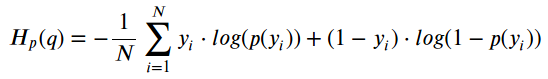

Minimizing cross entropy loss leads to the best model, i.e., the one that predicts the highest probability for the correct class.

In terms of weights and biases, our goal is to find the values for these parameters that minimize the cross entropy loss function. This is typically achieved through an iterative process like gradient descent, where we start with random values for weights and biases and then iteratively adjust these values in the direction that most decreases the cross entropy loss.

In a nutshell the procedure would look like this:
Initialize the weights and biases: Start with random values for the weights and biases. These are the initial "guesses" for the best values of these parameters.

1. Compute the loss: Use the current weights and biases to make predictions on the training data, and then compute the cross entropy loss. This tells us how well (or poorly) the current weights and biases are performing.

2. Compute the gradients: Calculate the gradients of the loss function with respect to the weights and biases. The gradient is a multi-dimensional derivative that tells us the slope of the loss function in every direction. It points in the direction of steepest ascent.

3. Update the weights and biases: Subtract a small multiple of the gradient from the current weights and biases. This "steps" in the direction of steepest descent, i.e., the direction that most decreases the loss.

4. Repeat: Repeat steps 2-4 many times. Until loss has decreased to our satisfied level or there are no significant decreases anymore.

It's important to understand how gradient decent works, in order to know how are these gradients being computed and how are the weights being updated for more info:
https://www.youtube.com/watch?v=het9HFqo1TQ&list=PLoROMvodv4rMiGQp3WXShtMGgzqpfVfbU&index=3



## Training the model using LogisticRegression and Interpreting using sklearn library

In [69]:
from sklearn.linear_model import LogisticRegression

In [70]:
model = LogisticRegression(solver='liblinear', random_state=42)

In [71]:
train_df

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,WindDir3pm_nan,RainToday_No,RainToday_Yes
0,0.516509,0.523629,0.001617,0.036483,0.524759,0.294574,0.153846,0.275862,0.71,0.22,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
1,0.375000,0.565217,0.000000,0.036483,0.524759,0.294574,0.030769,0.252874,0.44,0.25,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
2,0.504717,0.576560,0.000000,0.036483,0.524759,0.310078,0.146154,0.298851,0.38,0.30,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
3,0.417453,0.620038,0.000000,0.036483,0.524759,0.139535,0.084615,0.103448,0.45,0.16,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.613208,0.701323,0.002695,0.036483,0.524759,0.271318,0.053846,0.229885,0.82,0.33,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144548,0.599057,0.718336,0.000000,0.036483,0.524759,0.286822,0.184615,0.298851,0.22,0.13,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
144549,0.556604,0.786389,0.000000,0.036483,0.524759,0.193798,0.146154,0.229885,0.16,0.08,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
144550,0.608491,0.805293,0.000000,0.036483,0.524759,0.255814,0.200000,0.103448,0.15,0.08,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
144551,0.674528,0.818526,0.000000,0.036483,0.524759,0.286822,0.215385,0.195402,0.22,0.09,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


The parameter max_iteration of fit method by default is 100, this means that it will run 100 times and do predictions, calculate errors, modify weights and bias.

In [72]:
model.fit(train_df, y_train)

LogisticRegression(random_state=42, solver='liblinear')

We can check the weights assigned for each feature

In [73]:
print(train_df.columns)
print(model.coef_.tolist())

Index(['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm',
       ...
       'WindDir3pm_SE', 'WindDir3pm_SSE', 'WindDir3pm_SSW', 'WindDir3pm_SW',
       'WindDir3pm_W', 'WindDir3pm_WNW', 'WindDir3pm_WSW', 'WindDir3pm_nan',
       'RainToday_No', 'RainToday_Yes'],
      dtype='object', length=118)
[[0.8933657753851407, -2.8573990873585706, 3.170245334469797, 0.8897742654711234, -1.6702550949577437, 6.764058062853446, -0.9326141409664461, -1.4286839576532273, 0.32252907357399063, 5.993078235516696, 5.49004998186393, -9.203087401197282, -0.15988054755824807, 1.2893485568418837, 0.47551902636995685, 2.0010504641891096, 0.6082290534226746, -0.5506775630860585, 0.4750390232612247, 0.0020776393300315915, 0.350887334413674, -0.3560535124107311, 0.1738934795738383, 0.4368618514336786, -0.017814586670649182, 0.025823773213301503, 0.2519663583822428, -0.024144895206028274, -0.036287857102211864,

We could see that maxtemp has a negative weight, this could mean that it's not much effecting our target variable. Rainfall has a positive, temperature has positive value etc.
The model has learned the weights, if sunshine, the value is highly negative... 

The higher the weight, the highly correlated feature with our target.

In [79]:
weight_df = pd.DataFrame({
    'feature': train_df.columns,
    'weight': model.coef_.tolist()[0]
})
weight_df

,feature,weight
0,MinTemp,0.893366
1,MaxTemp,-2.857399
2,Rainfall,3.170245
3,Evaporation,0.889774
4,Sunshine,-1.670255
...,...,...
113,WindDir3pm_WNW,-0.104476
114,WindDir3pm_WSW,-0.346955
115,WindDir3pm_nan,0.000000
116,RainToday_No,-1.509661


<Axes: xlabel='weight', ylabel='feature'>

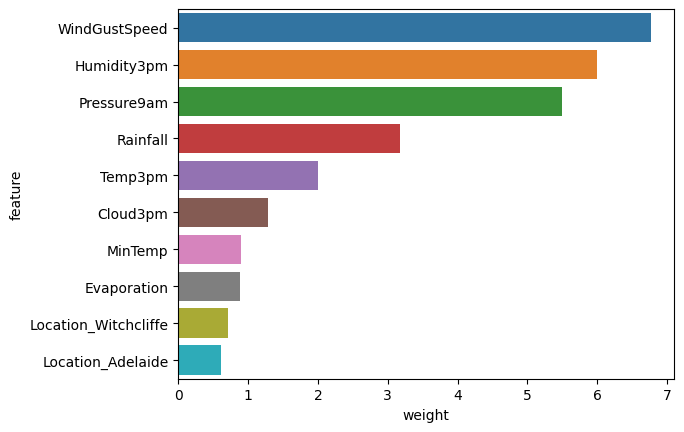

In [80]:
sns.barplot(data=weight_df.sort_values('weight', ascending=False).head(10), x='weight', y='feature')

As we can see from the plot above, the most important features, with higher weights, that affect our target variable are WindGustSpeed, Humidity3pm, ...

In [81]:
train_predictions = model.predict(train_df)
train_predictions

array(['No', 'No', 'No', ..., 'No', 'No', 'No'], dtype=object)

In [82]:
y_train

0         No
1         No
2         No
3         No
4         No
          ..
144548    No
144549    No
144550    No
144551    No
144552    No
Name: RainTomorrow, Length: 97988, dtype: object

### Evalutation of our model

Count the number of matches between predictions and acutal values, devide by number of predictions (days) | total rows


In [83]:
from sklearn.metrics import accuracy_score

accuracy_score(y_train, train_predictions)

0.8519512593378781

This is the accuracy of our model on the training data is 85%.
We could also return probabilities, for each prediction we will have probabilities.

In [84]:
model.classes_

array(['No', 'Yes'], dtype=object)

In [85]:
train_probabilities = model.predict_proba(train_df)
train_probabilities

array([[0.94451007, 0.05548993],
       [0.94115295, 0.05884705],
       [0.9607764 , 0.0392236 ],
       ...,
       [0.9874842 , 0.0125158 ],
       [0.98333265, 0.01666735],
       [0.87448633, 0.12551367]])

In [86]:
from sklearn.metrics import confusion_matrix

Better metric to evaluate our performance of our model is Confusion Matrix

The four terms in the matrix are:

True Positives (TP): These are the cases where the model predicted 'Yes' and the actual class was also 'Yes'.

True Negatives (TN): These are the cases where the model predicted 'No' and the actual class was also 'No'.

False Positives (FP): These are the cases where the model predicted 'Yes' but the actual class was 'No'. This is also known as "Type I error."

False Negatives (FN): These are the cases where the model predicted 'No' but the actual class was 'Yes'. This is also known as "Type II error."

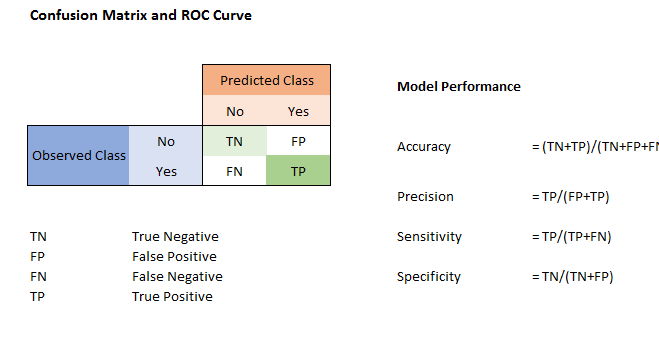


In [87]:
confusion_matrix(y_train, train_predictions, normalize='true') 

array([[0.94614779, 0.05385221],
       [0.47729149, 0.52270851]])

As we can see from the matrix, the model is good on predicting that it will NOT RAIN TOMORROW (TN)

But the True Positive value is not that good, which checks if It has Rained tomorrow and the model predicted to rain tomorrow.

The False Positives (meaning the true value was It's NOT going to rain tomorrow, but the model said YES it's gonna rain) is really low. 

And False Negatives, where it has Rained but the model Predicted as its NOT going to rain tomorrow. 

Based on the problem we're trying to solve we have to focus on false negatives, and false positives. 

If were trying to check if we want to host a game of tennis tomorrow, but number of false negatives is high, then our model is not performing good, since it will most likely not predict 
well that's going to rain tommorrow. Because the model will predict that it's NOT going to rain. so you try to reduce the false negatives, even if it reduces the accuracy.

If were trying to recommend chemiotherapy for breast cancer, then we look at False Positives, because we predicted that person has cancer, but it actually didn't. It was False Positive. So depending on problem we optimize these values.

This model based on confusion matrix, is not that good since it has only 47 accuracy on predicting Rain tomorrow, its like 50 50.

#### The reason that the TN is only .5 and TP is .94 is mostly because the dataset is imbalanced, and that should be fixed in order to get better results. This model is biased towards predicting the NO raing Tomorrow, and it still hasn't learned much on predicting if its going to rain.

In [89]:
test_predictions = model.predict(test_df)
accuracy_score(y_test, test_predictions)

0.8419292104239595

### Next Steps 

1. Handling Class-Imbalance, since we can see that the algorithm is heavily biased towards the majority class No Rain Tomorrow.
    - apply techniques like under or over sampling, SMOTE, Tuning Class weights or other methods (experiment with this by always checking the results)


2. We could experiment more with logistic regression, and change the threshold of 0.5 (decision boundary), and get the one that best fits our nature of the problem.

2. Use validation set for hyperparameter tuning

3. After experimenting with parameters and handling class-imbalances, try to fit in a single input to the model, and check the probabilities of Raining Tomorrow or Not.

4. Use other classification algorithms, such as Random Forests, or XGBOOST. 

## Random Forest Classifier

#### Bagging

Bagging, also known as bootstrap aggregating, is a strategy used to make our predictions more reliable. It works by reducing something called variance in our predictions.

To understand bagging, it's helpful to know two terms: 'variance' and 'independent and identically distributed (i.i.d.)'.

Variance is a measure of how much values in a dataset differ from the average value. In simple words, it's a way of understanding how spread out the data is. For instance, if we predict the price of a house based on certain features, the variance would be how much the predicted prices differ from the average predicted price. High variance might mean that our model performs very well on some data but very poorly on other data, which is not ideal.

Now, 'independent and identically distributed' or 'i.i.d.' is a term used to describe a scenario where all the elements in a sequence have the same probability distribution and each item in the sequence does not depend on the other items. In other words, it's like drawing cards from a deck, replacing the card each time — each draw doesn't affect the others and has the same odds.

So, what bagging does is that it averages the predictions from multiple models, each of which is trained on a different set of i.i.d. samples. This averaging process reduces the variance, meaning our predictions become more reliable and less scattered. In simpler terms, by using bagging, we're gathering opinions from several models instead of relying on one, and this leads to a more stable and accurate final prediction.

#### Decision Trees

Before using Random Forest algorithm, it's important to have an understanding of Decision Tree model.

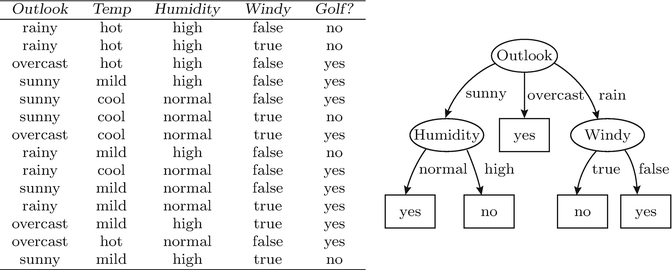

Given the table above, if we would wan't to decide if we should play golf or not. We can train a decision tree, which constructs the tree given the dataset, and it creates this hierarchical structure where in each node we have a decision to make (this tree is created using a computer instead of us manually having to figure out the best decisions that lead us to an answer of our problem)

Another more specifc example can be this tree that was trained using sk-learn DecisionTreeClassifier class.
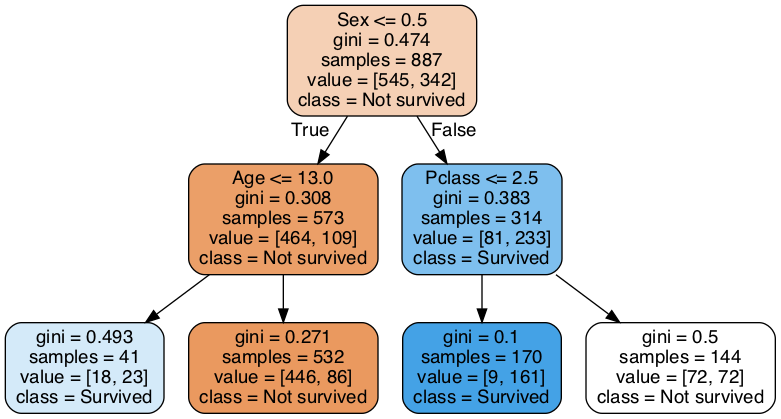

We can see a gini value in each box, this is the loss function used by decision tree to decide which colum should be used for splitting the data, and at what value it should be splitted. A lower gini value a better split in a sense that the accuracy of predicting that class in that node is higher. A perfect split (which indicates that all data that belongs to a same class was gathered in that node) has Gini index of 0.

In Decision Tree in each step, there are subsets of data created and splitted to each to other nodes that are created. The tree can be splitted until all data points in each node belong to a same class which indicates a perfect classification (mostly overfitting).

#### Random Forests

Decision trees have a tendency to overfit the training data. That means they can get so good at predicting the examples they've seen, that they perform poorly on new, unseen data. They may also be sensitive to small changes in the data, leading to drastically different trees.

Random Forest helps overcome these issues. It creates a whole forest of different decision trees, each trained on a different set of samples from the data (this is the 'bagging' part), and each tree only gets a subset of the features to make decisions on (this is the 'random' part). By doing so, Random Forest makes sure that the trees are diverse and not correlated to each other.

When a new prediction needs to be made, Random Forest takes the input, has each of the decision trees in the forest make a prediction, and then takes the majority vote of the predictions as the final decision. This way, the model leverages the wisdom of the crowd, making the overall predictions more reliable and less susceptible to the overfitting of any individual tree.

In [90]:
from sklearn.ensemble import RandomForestClassifier

Using the same training / test set I've created a base model, with the default parameters of RandomForsetClassifier. We will use this model for initial predictions and then further improve it using techniques such as GridSearchCv to find the best possible parameters which give us best results.

In [91]:
model = RandomForestClassifier(n_jobs=-1, random_state=42)

model.fit(train_df, y_train)

print("Accuracy on train set")
print(model.score(train_df, y_train))

print("Accuracy on validation set")
print(model.score(val_df, y_val))

Accuracy on train set
0.9999795893374699
Accuracy on validation set
0.8562233015390017


As we can se above, the model is overfitting, learning the training data but not generalizing well on validation data. The model is also perfoming good on validation with 85% accuracy.
Ensamble methods are poweful techique, errors of individual models cancel out when averagining. It takes too many decision trees to predict a wrong answer, in order to get a final wrong answer. 

We can also get probabilities to check the fraction of trees which predicted a given class.

### Get Feature Importance

<Axes: title={'center': 'Feature importances'}, xlabel='importances', ylabel='feature'>

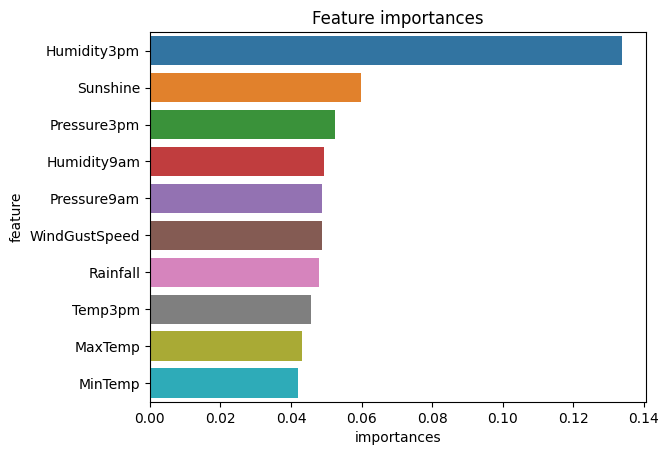

In [92]:
importance_df = pd.DataFrame({
    'feature': train_df.columns,
    'importances': model.feature_importances_
}).sort_values('importances', ascending=False)

plt.title("Feature importances")
sns.barplot(data=importance_df.head(10), x='importances', y='feature')

### Hyperparameter Tuning with Random Forest

Create a base model that we will compare it with our potentially imporved random forest model after hyperparameter tuning.

In [93]:
base_model = RandomForestClassifier(n_jobs=-1, random_state=42, class_weight={"No":1, "Yes":2})
base_model.fit(train_df, y_train)

print("Accuracy on train set")
print(model.score(train_df, y_train))

print("Accuracy on validation set")
print(model.score(val_df, y_val))

Accuracy on train set
0.9999795893374699
Accuracy on validation set
0.8562233015390017


n_estimators - We could modify the number of estimators (decision trees), the more decison trees the more randomness we have into our solution, which might reduce the overfitting.
Default is 100, try 200, 400, 800... and along the way check if the accuracy is getting better (way better), if it's not changing much just use less n of estimators so the cost of training doesn't get too high.

You should plot this change of accuracy, and choose the best value. In huge datasets you might care about this large number of n_estimators, else you can just gridsearch and find the best one. Increasing n_estimators, won't overfitt. 


* criterion: This is the function used to measure the quality of a split in the decision tree. In other words, it's used to decide which feature to use to split the data at each step in building the trees.
    - gini: Refers to the Gini impurity, a measure of misclassification, which aims to maximize the probability of correct classification.
    - entropy: Refers to information gain, which measures the reduction in entropy (randomness) achieved because of the split.

* max_depth - This is the maximum depth of the tree. This is useful to control overfitting.

* max_leaf_nodes - This is the maximum number of leaf nodes that the tree can have. This is useful to control overfitting.

* class_weight - We can use this to give more weight to the minority class. This is useful when we have a lot more data for one class than the other which is our case. 
you can also use class_weight as balanced which will automatically give more weight to the minority class.



In [94]:
from sklearn.model_selection import GridSearchCV

criterion = ['gini', 'entropy']       

n_estimators = [100, 200, 300]       

max_features = ['auto', 'sqrt']       

max_depth = [10, 20]      

max_depth.append(None)     

params = {'criterion': criterion,
          'n_estimators': n_estimators,
          'max_features': max_features,
          'max_depth': max_depth}

gs = GridSearchCV(base_model, param_grid=params, n_jobs=-1)
gs.fit(val_df, y_val)

/Users/diellor/opt/anaconda3/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:424: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.



GridSearchCV(estimator=RandomForestClassifier(class_weight={'No': 1, 'Yes': 2},
                                              n_jobs=-1, random_state=42),
             n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [10, 20, None],
                         'max_features': ['auto', 'sqrt'],
                         'n_estimators': [100, 200, 300]})

In [95]:
gs.best_params_


{'criterion': 'entropy',
 'max_depth': 10,
 'max_features': 'auto',
 'n_estimators': 300}

In [96]:
model = RandomForestClassifier(n_jobs=-1, random_state=42, class_weight={"No":1, "Yes":2}, criterion='entropy', max_depth=10, max_features='auto', n_estimators=300)
model.fit(train_df, y_train)

predictions = model.predict(test_df)

print("Accuracy on test set")
print(accuracy_score(y_test, predictions))


/Users/diellor/opt/anaconda3/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:424: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.



Accuracy on test set
0.831660832360949


In [97]:
# Calculate confusion matrix
cm = confusion_matrix(y_test, predictions, normalize='true')

print(cm)

[[0.9067136  0.0932864 ]
 [0.42454936 0.57545064]]


/Users/diellor/opt/anaconda3/lib/python3.8/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/Users/diellor/opt/anaconda3/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/Users/diellor/opt/anaconda3/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(

/Users/diellor/opt/anaconda3/lib/python3.8/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/Users/diellor/opt/anaconda3/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/Users/diellor/opt/anaconda3/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(

/Users/diellor/opt/anaconda3/lib/python3.8/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/Users/diellor/opt/anaconda3/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/Users/diellor/opt/anaconda3/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(

/Users/diellor/opt/anaconda3/lib/python3.8/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/Users/diellor/opt/anaconda3/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/Users/diellor/opt/anaconda3/lib/python3.8/site-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(

### Conclusions and Next Steps

Random Forest model performs better then our logistic regression, it has less False Negatives which is good in this specifc problem
1. Use better techniques for fixing class-imbalances, such as SMOTE to further improve our model.
2. Try different classification models such as SVM, XGBOOST etc.
3. Based on feature importance, maybe remove some of the features and check if the model's accuracy is improving.